# Project Assignment B: "The Viz and the Notebook"

This is the notebook by Raquel Chaves, Alba Pi, and Silvia Gonzalez for the second part of the assignment.

#### Outline

**1. Motivation**  
**2. Basic Statistics & EDA**  
**3. Data Analysis**  
**4. Storytelling Choices**  
**5. Visualizations**  
**6. Discussion & Critique**  
**7. Contributions**


## 1. Motivation
- **What is your dataset?**  
- **Why did you choose this/these particular dataset(s)?**  
- **What was your goal for the end user's experience?**  
---

- **What is your dataset?**  
    Our dataset includes information on tourist accommodations in four of Spain’s most visited provinces. It contains details such as the type of accommodation, the accommodation’s name, the owner’s contact information, address, and more. In some of the datasets, we also have the registration dates of these accommodations in the official registries of their respective autonomous communities. This first dataset comprises all officially registered accommodations in the Community of Madrid, the Valencian Community, Catalonia, and Mallorca.
    The second dataset we used is Airbnb data on tourist accommodations for these same autonomous communities. This will allow us to broadly compare officially registered versus unregistered accommodations.Airbnb listings must be officially registered in the autonomous communities’ tourism registries.

- **Why did you choose these particular datasets?**  
    Tourist apartments are currently not especially regulated. However, after many discussions and complaints from citizens, a law was approved this year requiring owners to register with the corresponding autonomous community registry, thereby obtaining a code that the platform will verify and display in the listings to ensure the rental is legal and legitimate. If an Airbnb listing lacks a registration number, it will not be allowed to remain published once the regulation is fully in force on July 1, 2025. The law came into effect on January 2, 2025, although its full and mandatory application for listing on digital platforms will begin on July 1, 2025. With this work, we aim to demonstrate the need for this law and to observe, prior to its mandatory application, how many accommodations comply with it. Our data were downloaded on April 3, 2025.

    We chose these datasets because the autonomous communities make their official tourism registries publicly available, and the Airbnb data were downloaded directly from the platform. It would be interesting to include data from other booking sites such as Booking.com, but unfortunately those are not publicly accessible.
    
    We also have housing price data sourced from Idealista, Spain’s leading real estate portal. With this, we will demonstrate the correlation between the growth in the number of tourist apartments and the rise in housing prices.

- **What was your goal for the end user's experience?**  
What we aim to achieve with this is for the user to step into the shoes of the problem, to “travel” through the data and explore the similarities between these autonomous communities. We also want to highlight the issue Spanish citizens face with rising rental-housing prices due to the low supply of apartments, houses, and flats for living—many of which are being used for tourism. Obviously, the housing problem is not solely a consequence of tourism, but it is one of the reasons, since property owners earn higher profits by renting apartments short-term through these platforms than by leasing them long-term.

## 2. Basic Statistics & EDA
1. **Data Cleaning & Preprocessing**  
2. **Key Dataset Stats**  
3. **Exploratory Plots** 

---

In [265]:
#import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import folium
import math
import seaborn as sns
from scipy.stats import probplot
import re 
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import ColumnDataSource, CheckboxGroup, CustomJS, Legend
from bokeh.layouts import column
from bokeh.palettes import Category10

import warnings
warnings.filterwarnings('ignore')

### Data Cleaning & Preprocessing  

**Airbnb Data**

In [266]:
# read the airbnb data
bcn_bnb = pd.read_csv('/Users/albapi/Desktop/uni/2n_sem/social_data/social_data_assignments/final_project/data/listings_barcelona.csv')
mad_bnb = pd.read_csv('/Users/albapi/Desktop/uni/2n_sem/social_data/social_data_assignments/final_project/data/listings_madrid.csv')
mall_bnb = pd.read_csv('/Users/albapi/Desktop/uni/2n_sem/social_data/social_data_assignments/final_project/data/listings_mallorca.csv')

All the columns are the same in all the files, so a common function is created to filter all the files in the same way. 

In [267]:
def filter_df(file):
    
    # keep only the columns we are interested in
    file_filt = file[['id', 'name', 'host_name', 'host_id', 'host_since', 'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude', 'longitude', 'room_type', 'price', 'last_review',
                        'license', 'property_type', 'host_location']]

    # rename some columns for better clarity
    file_filt.rename(columns={'neighbourhood_group_cleansed': 'district'}, inplace=True)
    file_filt.rename(columns={'neighbourhood_cleansed': 'neighbourhood'}, inplace=True)

    # filter for last_rewview, keep only reviews of 2024 and 2025, to get the apartments that are still active
    file_filt['last_review'] = pd.to_datetime(file_filt['last_review'], errors='coerce')
    file_filt['last_review'] = file_filt['last_review'].dt.year
    file_filt = file_filt.dropna(subset=['last_review'])
    file_filt['last_review'] = file_filt['last_review'].astype(int)
    file_filt = file_filt[file_filt['last_review'] >= 2024]

    # look for duplicated based on name, host_name, latitude and longitude and keep only the first one
    file_filt = file_filt.drop_duplicates(subset=['name', 'host_name', 'latitude', 'longitude'], keep='first')

    return file_filt

In [268]:
# filter the dataframes
bcn_filt_bnb = filter_df(bcn_bnb)
mad_filt_bnb = filter_df(mad_bnb)
mall_filt_bnb = filter_df(mall_bnb)

**Government Data**

In [269]:
# read government data
bcn_gov = pd.read_csv('/Users/albapi/Desktop/uni/2n_sem/social_data/social_data_assignments/final_project/data/catalunya.csv')
mad_gov = pd.read_csv('/Users/albapi/Desktop/uni/2n_sem/social_data/social_data_assignments/final_project/data/madrid.csv')
mall_gov = pd.read_csv('/Users/albapi/Desktop/uni/2n_sem/social_data/social_data_assignments/final_project/data/mallorca.csv', delimiter=';', on_bad_lines='skip')

The preprocessing is made differently for each dataframe, because they have different columns. 

In [270]:
# the preprocessing is made differently for each dataframe, because they have different columns
# CATALUNYA

# we choosd only the turistic apartments, and eliminate hotels, camings and rural houses
bcn_filt_gov = bcn_gov[bcn_gov['Tipus establiment'].isin(['Apartaments Turístics', 'Apartaments turístics', "Habitatges d'ús turístic"])]

# we create an address column
bcn_filt_gov['address'] = bcn_filt_gov['Tipus de via'] + ' ' + bcn_filt_gov['Nom de la via'] + ' ' + bcn_filt_gov['Número'].astype(str)

# we keep only the columns we are interested in
bcn_filt_gov = bcn_filt_gov[['Número inscripció', 'Rètol', 'Estat','address', 'Codi Postal', 'Municipi', 'Comarca']]

# rename some columns for better clarity
bcn_filt_gov.rename(columns={'Número inscripció': 'license'}, inplace=True)
bcn_filt_gov.rename(columns={'Estat': 'state'}, inplace=True)
bcn_filt_gov.rename(columns={'Rètol': 'name'}, inplace=True)
bcn_filt_gov.rename(columns={'Codi Postal': 'cdpostal'}, inplace=True)

# we keep only the rows that correspond to the city of Barcelona
bcn_filt_gov = bcn_filt_gov[bcn_filt_gov['Comarca'] == 'Barcelonès']
bcn_filt_gov = bcn_filt_gov[bcn_filt_gov['Municipi'] == 'Barcelona']

# we keep only the active apartments
bcn_filt_gov = bcn_filt_gov[bcn_filt_gov['state'] == 'Alta']

# look for duplicated based on the name of the apartment and its address
bcn_filt_gov = bcn_filt_gov.drop_duplicates(subset=['address','name'], keep='first')


In [271]:
# MADRID
# we choose only the turistic apartments
mad_filt_gov = mad_gov[mad_gov['alojamiento_tipo'].isin(['APART-TURISTICO', 'VIVIENDAS DE USO TU'])]

# we create and address column
mad_filt_gov['address'] = mad_filt_gov['via_tipo'] + ' ' + mad_filt_gov['via_nombre'] + ' ' + mad_filt_gov['numero'].astype(str)

# we keep only the columns we are interested in
mad_filt_gov = mad_filt_gov[['signatura', 'denominacion', 'address', 'cdpostal', 'localidad']]

# rename some columns for better clarity
mad_filt_gov.rename(columns={'signatura': 'license'}, inplace=True)
mad_filt_gov.rename(columns={'denominacion': 'name'}, inplace=True)

# we keep only the rows that correspond to the city of Madrid
mad_filt_gov = mad_filt_gov[mad_filt_gov['localidad'] == 'Madrid']

# look for duplicated based on the name of the apartment and its address
mad_filt_gov = mad_filt_gov.drop_duplicates(subset=['address','name'], keep='first')

In [272]:
# MALLORCA
# we choose only the turistic apartments
mall_filt_gov = mall_gov[mall_gov['Grup'].isin(['Estada turística en habitatge (ETVPL)',
 'Estada turística en habitatge (ETV)',
 'Estada turística en habitatge (ETV60)', 'Habitatge turístic de vacances'])]

# we keep only the columns we are interested in
mall_filt_gov = mall_filt_gov[['Signatura', 'Direcció', 'Denominació comercial', 'Localitat', 'Municipi', 'Estat', 'Inici dactivitat']]

# rename some columns for better clarity
mall_filt_gov.rename(columns={'Signatura': 'license', 'Denominació comercial': 'name', 'Direcció': 'address', 'Inici dactivitat': 'Inici activitat'}, inplace=True)

# look for duplicated based on the name of the apartment and its address
mall_filt_gov = mall_filt_gov.drop_duplicates(subset=['address','name'], keep='first')

### Key Dataset Statistics 

**Airbnb Data**

In [273]:
# number of rows in the filtered dataframes
print('Number of rows in the filtered Barcelona dataframe: ', bcn_filt_bnb.shape[0])
print('Number of rows in the filtered Madrid dataframe: ', mad_filt_bnb.shape[0])
print('Number of rows in the filtered Mallorca dataframe: ', mall_filt_bnb.shape[0])

#total number of rows in the airbnb dataframes
print('\nTotal number of rows from Airbnb: ', bcn_filt_bnb.shape[0]+mad_filt_bnb.shape[0]+mall_filt_bnb.shape[0])

Number of rows in the filtered Barcelona dataframe:  11777
Number of rows in the filtered Madrid dataframe:  16727
Number of rows in the filtered Mallorca dataframe:  10275

Total number of rows from Airbnb:  38779


We have a total of over 38,000 rows of data from Airbnb listings in Barcelona, Madrid, and Mallorca.

In [274]:
#number of rows in the filtered government dataframes
print('Number of rows in the filtered Barcelona government dataframe: ', bcn_filt_gov.shape[0])
print('Number of rows in the filtered Madrid government dataframe: ', mad_filt_gov.shape[0])
print('Number of rows in the filtered Mallorca government dataframe: ', mall_filt_gov.shape[0])

#total number of rows in the government dataframes
print('\nTotal number of rows from government: ', bcn_filt_gov.shape[0]+mad_filt_gov.shape[0]+mall_filt_gov.shape[0])

Number of rows in the filtered Barcelona government dataframe:  5022
Number of rows in the filtered Madrid government dataframe:  8986
Number of rows in the filtered Mallorca government dataframe:  16833

Total number of rows from government:  30841


We have over 30,000 rows of data from official government records on registered tourist accommodations in Barcelona, Madrid, and Mallorca — about 8,000 fewer than the number of listings available from Airbnb.

## Exploratory Analysis

For the Exploratory Data Analysis, we start by examining where hosts declare their location. This helps determine how many listings are managed by local hosts versus those living elsewhere, offering insights into potential professionalization of rentals.

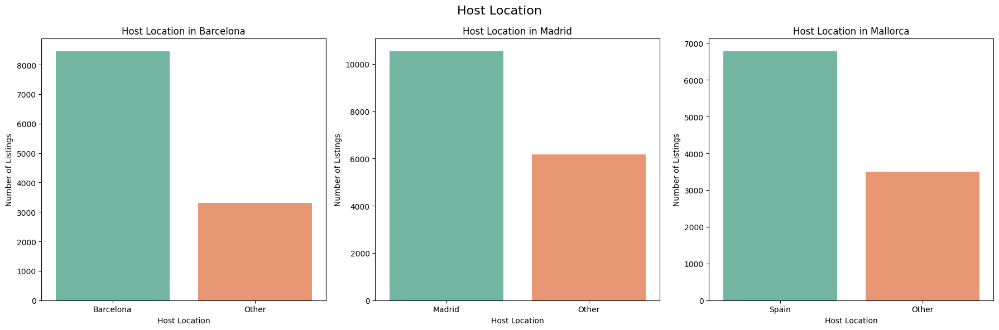

In [275]:
def plot_host_location(df, city_name, title):

    # Classify host locations
    df['host_location'] = df['host_location'].apply(
        lambda x: city_name if isinstance(x, str) and city_name.lower() in x.lower() else 'Other'
    )

    # Plot
    sns.countplot(data=df, x='host_location', palette='Set2')
    plt.title(f'Host Location in {title}')
    plt.xlabel('Host Location')
    plt.ylabel('Number of Listings')
    plt.xticks(rotation=0)

# Plotting
plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
plot_host_location(bcn_filt_bnb, 'Barcelona', 'Barcelona')
plt.subplot(1, 3, 2)
plot_host_location(mad_filt_bnb, 'Madrid', 'Madrid')
plt.subplot(1, 3, 3)
plot_host_location(mall_filt_bnb, 'Spain', 'Mallorca')
plt.suptitle('Host Location', fontsize=16)
plt.tight_layout()
plt.show()



Next, we analyze the price distribution of listings. The distributions are skewed due to a few high-priced properties, so we apply a cutoff to focus on more representative pricing. A mean price line is added for reference.

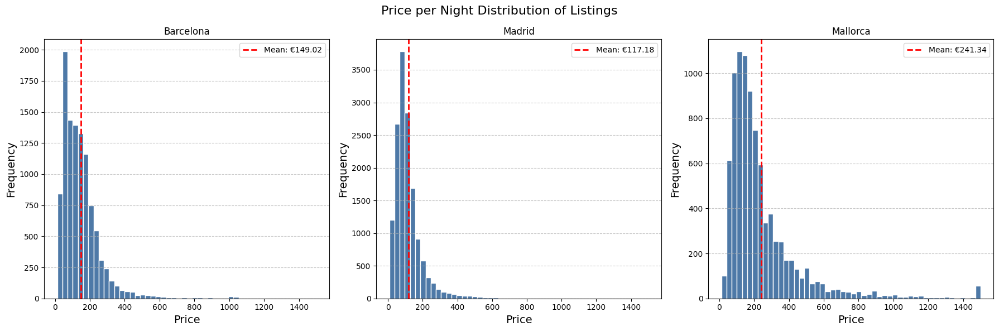

In [276]:
def plot_price_distribution(df, city_name, price_col='price', max_price=1500):

    # Clean and convert price column
    df[price_col] = df[price_col].replace('[\$,]', '', regex=True).astype(float)

    # Filter out high prices
    df = df[df[price_col] <= max_price]
    
    mean_price = df[price_col].mean()

    # Plot
    plt.hist(df[price_col], bins=50, color='#4E79A7', edgecolor='white')
    plt.axvline(mean_price, color='red', linestyle='dashed', linewidth=2, label=f'Mean: €{mean_price:.2f}')
    plt.title(city_name)
    plt.xlabel('Price', fontsize=14)
    plt.ylabel('Frequency', fontsize=14)
    plt.legend()
    plt.grid(axis='y', linestyle='--', alpha=0.7)


# Plotting
plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
plot_price_distribution(bcn_filt_bnb, 'Barcelona')
plt.subplot(1, 3, 2)
plot_price_distribution(mad_filt_bnb, 'Madrid')
plt.subplot(1, 3, 3)
plot_price_distribution(mall_filt_bnb, 'Mallorca')
plt.suptitle('Price per Night Distribution of Listings', fontsize=16)
plt.tight_layout()
plt.show()


Legal compliance is a key aspect of short-term rentals. We visualize the proportion of listings that include a license number versus those that don’t, providing a sense of how widespread non-compliance might be in each city.

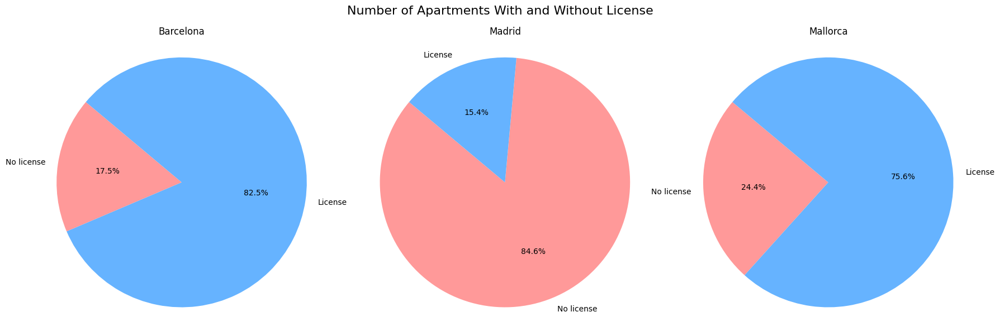

In [277]:
# Add a new column to indicate whether the license is registered
bcn_filt_bnb['is_registered_bnb'] = bcn_filt_bnb['license'].notna() & (bcn_filt_bnb['license'].astype(str).str.strip() != '')
mad_filt_bnb['is_registered_bnb'] = mad_filt_bnb['license'].notna() & (mad_filt_bnb['license'].astype(str).str.strip() != '')
mall_filt_bnb['is_registered_bnb'] = mall_filt_bnb['license'].notna() & (mall_filt_bnb['license'].astype(str).str.strip() != '')

# Define function to plot pie chart
def count_licenses(df, title):
    counts = df['is_registered_bnb'].value_counts()
    labels = ['No license', 'License']
    sizes = [counts.get(False, 0), counts.get(True, 0)]
    colors = ['#ff9999','#66b3ff']
    plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=140)
    plt.axis('equal')
    plt.title(title)

# Plotting
plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
count_licenses(bcn_filt_bnb, 'Barcelona')
plt.subplot(1, 3, 2)
count_licenses(mad_filt_bnb, 'Madrid')
plt.subplot(1, 3, 3)
count_licenses(mall_filt_bnb, 'Mallorca')
plt.suptitle('Number of Apartments With and Without License', fontsize=16)
plt.tight_layout()
plt.show()


We also look at how many listings each host manages. This highlights the presence of multi-property hosts and can suggest whether the platform is used more by individuals or large-scale operators.

Number of duplicate rows in Barcelona: 9306
Number of duplicate rows in Madrid: 11574
Number of duplicate rows in Mallorca: 7457


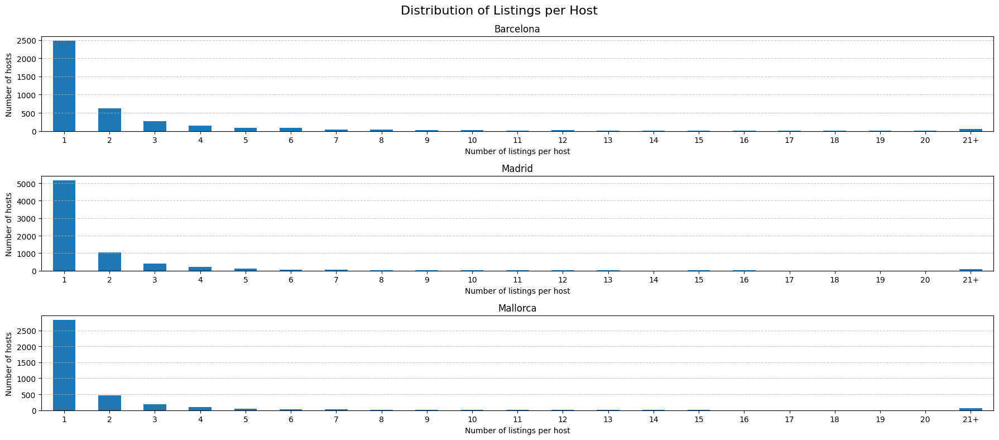

In [278]:
# Find duplicates
def find_duplicates(df, city):
    duplicates = df[df['host_id'].duplicated(keep= False)]
    unique_hosts = df[~df['host_id'].duplicated(keep=False)]
    host_id_counts = df['host_id'].value_counts()

    #counts_of_counts = host_id_counts.value_counts().sort_index()
    print(f"Number of duplicate rows in {city}: {duplicates.shape[0]}")

    capped_counts = host_id_counts.apply(lambda x: x if x <= 20 else 21)
    counts_of_counts = capped_counts.value_counts().sort_index()
    counts_of_counts.index = counts_of_counts.index.map(lambda x: str(x) if x <= 20 else '21+')

    counts_of_counts.plot(kind='bar')
    plt.xlabel('Number of listings per host')
    plt.ylabel('Number of hosts')
    plt.title(city)
    plt.xticks(rotation=0)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    

# Plotting
plt.figure(figsize=(18, 8))
plt.subplot(3, 1, 1)
find_duplicates(bcn_filt_bnb, 'Barcelona')
plt.subplot(3, 1, 2)
find_duplicates(mad_filt_bnb, 'Madrid')
plt.subplot(3, 1, 3)
find_duplicates(mall_filt_bnb, 'Mallorca')
plt.suptitle('Distribution of Listings per Host', fontsize=16)
plt.tight_layout()
plt.show()



Finally, we plot the listings on a map and color them by district, with this, we gain an understanding of the spatial spread of apartments in each city. This visualization helps identify the most saturated or tourist-oriented areas. Only valid for Barcelona and Madrid, as Mallorca is treated as the whole island and the term 'Neighbourhood' does not apply.

In [279]:
def plot_apartments_by_district(df, city_name='City', lat_col='latitude', lon_col='longitude', district_col='district'):
    # Generate a color palette
    unique_districts = df[district_col].dropna().unique()
    palette = sns.color_palette("hsv", len(unique_districts)).as_hex()
    district_colors = dict(zip(unique_districts, palette))

    # Initialize the map
    m = folium.Map(location=[df[lat_col].mean(), df[lon_col].mean()], zoom_start=13)

    # Add CircleMarkers for each apartment
    for _, row in df.iterrows():
        if pd.notna(row[district_col]):
            folium.CircleMarker(
                location=[row[lat_col], row[lon_col]],
                radius=6,
                color=district_colors[row[district_col]],
                fill=True,
                fill_color=district_colors[row[district_col]],
                fill_opacity=0.7,
                popup=f"District: {row[district_col]}"
            ).add_to(m)

    return m

plot_apartments_by_district(mad_filt_bnb, city_name='Madrid')




## 3. Data Analysis
- **Descriptive Findings**  
- **Predictive Modeling** 

---

### How big is the problem?

We want to analyze how many apartments are correctly registered in the government database and how many are not. To do this, we created a set containing all the licenses from the ‘license’ column of the government dataframes and checked how many of them matched the licenses listed in the Airbnb dataset.

After performing this comparison, we found that the number of matches was surprisingly low. This led us to revisit our exploratory analysis and compare the results obtained here with the ones obtained there, which were obtained by checking whether the ‘license’ column in the Airbnb data was filled or not. Finbally, we found that the differences between both methods were quite significant, especially in Barcelona and Mallorca.

In the end, we decided to rely on the second approach (based on whether the ‘license’ column in the Airbnb data contains a value) as our main classification criterion. We made this decision because the government data may not be fully up to date, and this could be contributing to the observed differences. Moreover, even though taken into account, licenses might be written in different formats, making exact matches unreliable even when the license is valid.

In [280]:
def check_licenses(bnb_df, gov_df, city_name):

    # EDA - from before
    bnb_df['is_registered'] = bnb_df['license'].notna() & (bnb_df['license'].astype(str).str.strip() != '')
    counts1 = bnb_df['is_registered'].value_counts()

    # Normalize license fields in both datasets
    bnb_df['license2'] = bnb_df['license'].astype(str).str.lower().str.replace(r'[-/.,\s]', '', regex=True)
    gov_df['license2'] = gov_df['license'].astype(str).str.lower().str.replace(r'[-/.,\s]', '', regex=True)

    # Prepare list and set of valid licenses
    licenses_gov = gov_df['license2'].tolist()
    licenses_gov.append('exempt') 
    licenses_gov_set = set(licenses_gov)

    # Add new column indicating whether each listing is registered
    bnb_df['is_registered_bnb'] = bnb_df['license2'].isin(licenses_gov_set)

    # Count the number of listings with and without licenses
    counts2 = bnb_df['is_registered_bnb'].value_counts()
    print(f"\n{city_name}")
    print('Looking in the government data:')
    print(f"Number of listings with license: {counts2.get(True, 0)}")
    print(f"Number of listings without license: {counts2.get(False, 0)}")

    print('\nLooking in the airbnb data:')
    print(f"Number of listings with license (not null): {counts1.get(True, 0)}")
    print(f"Number of listings without license (not null): {counts1.get(False, 0)}")
    
    return bnb_df

check_bcn = check_licenses(bcn_filt_bnb, bcn_filt_gov, 'BARCELONA')
check_mad = check_licenses(mad_filt_bnb, mad_filt_gov, 'MADRID')
check_mall = check_licenses(mall_filt_bnb, mall_filt_gov, 'MALLORCA')



BARCELONA
Looking in the government data:
Number of listings with license: 5846
Number of listings without license: 5931

Looking in the airbnb data:
Number of listings with license (not null): 9712
Number of listings without license (not null): 2065

MADRID
Looking in the government data:
Number of listings with license: 1013
Number of listings without license: 15714

Looking in the airbnb data:
Number of listings with license (not null): 2568
Number of listings without license (not null): 14159

MALLORCA
Looking in the government data:
Number of listings with license: 5022
Number of listings without license: 5253

Looking in the airbnb data:
Number of listings with license (not null): 7763
Number of listings without license (not null): 2512


In [281]:
def create_map_interactive(bnb_df, zoom=13, col_name='is_registered_bnb'):

    # Define colors for map markers
    status_colors = {
        True: 'green',
        False: 'red'
    }

    # Create base map centered on average coordinates
    m = folium.Map(location=[bnb_df['latitude'].mean(), bnb_df['longitude'].mean()], zoom_start=zoom)

    # Create separate feature groups
    registered = folium.FeatureGroup(name='Registered (Green)', show=True)
    unregistered = folium.FeatureGroup(name='Unregistered (Red)', show=True)

    # Add listings to the appropriate group
    for _, row in bnb_df.iterrows():
        marker = folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=6,
            color=status_colors[row[col_name]],
            fill=True,
            fill_color=status_colors[row[col_name]],
            fill_opacity=0.7,
            popup=f"{row.get('name', 'Listing')}<br>Registered: {row[col_name]}"
        )
        if row[col_name]:
            marker.add_to(registered)
        else:
            marker.add_to(unregistered)

    # Add feature groups and controls to map
    registered.add_to(m)
    unregistered.add_to(m)
    folium.LayerControl(collapsed=False).add_to(m)

    return m

In [282]:
create_map_interactive(bcn_filt_bnb, zoom=13)

### Can we call this a bussiness?

In [286]:
room_types = mad_filt_bnb['room_type'].unique()
print("Room types in Madrid:", room_types)
room_types = bcn_filt_bnb['room_type'].unique()
print("Room types in Barcelona:", room_types)
room_types = mall_filt_bnb['room_type'].unique()
print("Room types in Mallorca:", room_types)

Room types in Madrid: ['Private room' 'Entire home/apt' 'Hotel room' 'Shared room']
Room types in Barcelona: ['Entire home/apt' 'Private room' 'Hotel room' 'Shared room']
Room types in Mallorca: ['Entire home/apt' 'Private room' 'Hotel room' 'Shared room']


In [289]:
def host_distribution(df):
    # Count listings per host and room type
    host_counts = df.groupby(['host_id', 'room_type']).size().reset_index(name='count')
    host_total = host_counts.groupby('host_id')['count'].sum().reset_index(name='total_listings')
    host_counts = pd.merge(host_counts, host_total, on='host_id')
    host_counts['listing_bin'] = host_counts['total_listings'].apply(lambda x: str(x) if x <= 10 else '11+')

    # Prepare data for stacked bar chart
    room_types = ['Entire home/apt', 'Private room', 'Hotel room', 'Shared room']
    listing_bins = sorted(host_counts['listing_bin'].unique(), key=lambda x: int(x) if x.isdigit() else 11)

    # Create pivot table
    pivot_data = {rt: [] for rt in room_types}
    for b in listing_bins:
        subset = host_counts[host_counts['listing_bin'] == b]
        for rt in room_types:
            pivot_data[rt].append(subset[subset['room_type'] == rt].shape[0])

    pivot_data['listing_bin'] = listing_bins
    source = ColumnDataSource(data=pivot_data)

    # Create the figure
    p = figure(x_range=listing_bins, height=500, width = 900, title="Listings per Host by Room Type",
            toolbar_location=None, tools="")

    colors = Category10[len(room_types)]
    renderers = []
    legend_items = []

    # Add stacked bars
    for i, rt in enumerate(room_types):
        r = p.vbar(x='listing_bin', top=rt, width=0.9, source=source, color=colors[i], legend_label=rt, alpha=0.7)
        renderers.append(r)

    p.y_range.start = 0
    p.xgrid.grid_line_color = None
    p.axis.minor_tick_line_color = None
    p.outline_line_color = None
    p.legend.orientation = "vertical"
    p.legend.location = "right"
    p.legend.click_policy = "hide"

    output_notebook()
    show(p)

In [291]:
host_distribution(mall_filt_bnb)

Loading BokehJS ...

## 4. Storytelling Choices
1. **Genre of Data Story**  
2. **Visual Narrative Tools** 
3. **Narrative Structure Tools** 

---

## 5. Visualizations
- **Chosen Charts**    
- **Story Fit**  

---

## 6. Discussion & Critique
- **What Went Well**  
- **Limitations & Next Steps**  
- **Opportunities for Improvement**  
---

## 7. Contributions
| Team Member       | Responsibilities                                 |
|-------------------|--------------------------------------------------|
| Raquel Chaves     | XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX|
| Alba Pi           | XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX|
| Silvia González   | XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX|